# Setting up the environment

In [1]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding
!nvidia-smi

Mon Jan 22 22:02:32 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   51C    P8              12W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [2]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-ufxg685e
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-ufxg685e
  Resolved https://github.com/facebookresearch/detectron2.git to commit 864913f0e57e87a75c8cc0c7d79ecbd774fc669b
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 1.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 19.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 68.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 17.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for detectron2: filename=detectron2-0.6-cp310-cp310-linux_x86_64.whl size=6119627 sha256=34b182df32a15091fe1748187c71

In [3]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.1 ; cuda:  cu121
detectron2: 0.6


In [4]:
# COMMON LIBRARIES
import os
import cv2

from datetime import datetime
from google.colab.patches import cv2_imshow

# DATA SET PREPARATION AND LOADING
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog

# VISUALIZATION
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode

# CONFIGURATION
from detectron2 import model_zoo
from detectron2.config import get_cfg

# EVALUATION
from detectron2.engine import DefaultPredictor

# TRAINING
from detectron2.engine import DefaultTrainer

# Importing Data

In [5]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="e5vEsRqwwVpFSxAQ8nYh")
project = rf.workspace("solarise").project("roof-top-detection-8eyrx")
dataset = project.version(6).download("coco-segmentation")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.9/69.9 kB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 26.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 16.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.5/77.5 kB 11.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 6.3 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.6
    Uninstalling idna-3.6:
      Successfully uninstalled idna-3.6
  Attempting uninstall: cycler
    Found existing installation: cycler

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Roof-Top-detection-6 in coco-segmentation:: 100%|██████████| 282/282 [00:00<00:00, 3538.99it/s]


In [6]:
DATA_SET_NAME = dataset.name.replace(" ", "-")
ANNOTATIONS_FILE_NAME = "_annotations.coco.json"
detectron2.data.MetadataCatalog
# MetadataCatalog.remove("Roof-Top-detection-train")
# MetadataCatalog.remove("Roof-Top-detection-test")
# MetadataCatalog.remove("Roof-Top-detection-valid")

MetadataCatalog(registered metadata: coco_2014_train, coco_2014_val, coco_2014_minival, coco_2014_valminusminival, coco_2017_train, coco_2017_val, coco_2017_test, coco_2017_test-dev, coco_2017_val_100, keypoints_coco_2014_train, keypoints_coco_2014_val, keypoints_coco_2014_minival, keypoints_coco_2014_valminusminival, keypoints_coco_2017_train, keypoints_coco_2017_val, keypoints_coco_2017_val_100, coco_2017_train_panoptic_separated, coco_2017_train_panoptic_stuffonly, coco_2017_train_panoptic, coco_2017_val_panoptic_separated, coco_2017_val_panoptic_stuffonly, coco_2017_val_panoptic, coco_2017_val_100_panoptic_separated, coco_2017_val_100_panoptic_stuffonly, coco_2017_val_100_panoptic, lvis_v1_train, lvis_v1_val, lvis_v1_test_dev, lvis_v1_test_challenge, lvis_v0.5_train, lvis_v0.5_val, lvis_v0.5_val_rand_100, lvis_v0.5_test, lvis_v0.5_train_cocofied, lvis_v0.5_val_cocofied, cityscapes_fine_instance_seg_train, cityscapes_fine_sem_seg_train, cityscapes_fine_instance_seg_val, cityscapes_f

In [7]:
# TRAIN SET
TRAIN_DATA_SET_NAME = f"{DATA_SET_NAME}-train"
TRAIN_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "train")
TRAIN_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "train", ANNOTATIONS_FILE_NAME)

dataset_name = 'coco_dataset'

if TRAIN_DATA_SET_NAME in DatasetCatalog.list():
    DatasetCatalog.remove(TRAIN_DATA_SET_NAME)

register_coco_instances(
    name=TRAIN_DATA_SET_NAME,
    metadata={},
    json_file=TRAIN_DATA_SET_ANN_FILE_PATH,
    image_root=TRAIN_DATA_SET_IMAGES_DIR_PATH
)

# TEST SET
TEST_DATA_SET_NAME = f"{DATA_SET_NAME}-test"
TEST_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "test")
TEST_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "test", ANNOTATIONS_FILE_NAME)

if TEST_DATA_SET_NAME in DatasetCatalog.list():
    DatasetCatalog.remove(TEST_DATA_SET_NAME)

register_coco_instances(
    name=TEST_DATA_SET_NAME,
    metadata={},
    json_file=TEST_DATA_SET_ANN_FILE_PATH,
    image_root=TEST_DATA_SET_IMAGES_DIR_PATH
)

# VALID SET
VALID_DATA_SET_NAME = f"{DATA_SET_NAME}-valid"
VALID_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "valid")
VALID_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "valid", ANNOTATIONS_FILE_NAME)

if VALID_DATA_SET_NAME in DatasetCatalog.list():
    DatasetCatalog.remove(VALID_DATA_SET_NAME)

register_coco_instances(
    name=VALID_DATA_SET_NAME,
    metadata={},
    json_file=VALID_DATA_SET_ANN_FILE_PATH,
    image_root=VALID_DATA_SET_IMAGES_DIR_PATH
)

In [8]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [9]:
[
    data_set
    for data_set
    in MetadataCatalog.list()
    if data_set.startswith(DATA_SET_NAME)
]

['Roof-Top-detection-train',
 'Roof-Top-detection-test',
 'Roof-Top-detection-valid']

Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.



{'file_name': '/content/Roof-Top-detection-6/train/46-10759914184923_19-651387226926634_jpg.rf.03f22d60b0f4076317df28bece19b55a.jpg', 'height': 640, 'width': 640, 'image_id': 1, 'annotations': [{'iscrowd': 0, 'bbox': [625, 1, 13.537, 77.198], 'category_id': 1, 'segmentation': [[638.224, 76.197, 637.273, 5.455, 624.688, 1.314, 629.666, 78.513, 638.224, 76.197]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [503, 0, 109.276, 48.374], 'category_id': 1, 'segmentation': [[612.028, 36.439, 608.182, 2.745, 502.752, 0.238, 512.678, 48.612, 572.557, 37.831, 612.028, 36.439]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [364, 1, 73.121, 104.173], 'category_id': 1, 'segmentation': [[437.138, 104.223, 436.364, 0.927, 375.43, 1.698, 376.179, 22.813, 364.016, 30.32, 366.953, 105.1, 404.379, 99.834, 437.138, 104.223]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [591, 192, 48.292, 134.624], 'category_id': 1, 'segmentation': [[637.983, 323.775, 639.091, 1

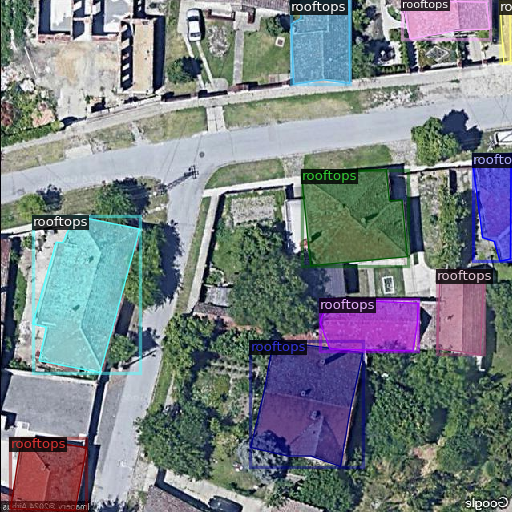

In [10]:

metadata = MetadataCatalog.get(TRAIN_DATA_SET_NAME)
dataset_train = DatasetCatalog.get(TRAIN_DATA_SET_NAME)

dataset_entry = dataset_train[1]

image = cv2.imread(dataset_entry["file_name"])

print(dataset_entry)

visualizer = Visualizer(
    image[:, :, ::-1],
    metadata=metadata,
    scale=0.8,
    instance_mode=ColorMode.IMAGE_BW
)

out = visualizer.draw_dataset_dict(dataset_entry)
cv2_imshow(out.get_image()[:, :, ::-1])

# Setting up hyperparameters

In [11]:
# HYPERPARAMETERS
ARCHITECTURE = "mask_rcnn_R_101_FPN_3x"
CONFIG_FILE_PATH = f"COCO-InstanceSegmentation/{ARCHITECTURE}.yaml"


# OUTPUT DIR
OUTPUT_DIR_PATH = os.path.join(
    DATA_SET_NAME,
    ARCHITECTURE,
    datetime.now().strftime('%Y-%m-%d-%H-%M-%S')
)

os.makedirs(OUTPUT_DIR_PATH, exist_ok=True)

In [12]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(CONFIG_FILE_PATH))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(CONFIG_FILE_PATH)
cfg.DATASETS.TRAIN = (TRAIN_DATA_SET_NAME,)
cfg.DATASETS.TEST = (TEST_DATA_SET_NAME,)
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.TEST.EVAL_PERIOD = 1000
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.INPUT.MASK_FORMAT='bitmask'
cfg.SOLVER.BASE_LR = 1e-3
cfg.SOLVER.GAMMA = 0.5
cfg.SOLVER.STEPS = (250, 500, 750)
cfg.SOLVER.MAX_ITER = 1000
cfg.SOLVER.WARMUP_ITERS = 100
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2
cfg.OUTPUT_DIR = OUTPUT_DIR_PATH

# Training pretrained model

In [13]:
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[01/22 22:10:48 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a3ec72.pkl: 254MB [00:01, 229MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[01/22 22:10:49 d2.engine.train_loop]: Starting training from iteration 0


torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)


[01/22 22:11:08 d2.utils.events]:  eta: 0:09:24  iter: 19  total_loss: 2.981  loss_cls: 1.127  loss_box_reg: 0.7976  loss_mask: 0.6887  loss_rpn_cls: 0.3443  loss_rpn_loc: 0.07287    time: 0.5917  last_time: 0.6584  data_time: 0.0487  last_data_time: 0.0597   lr: 0.00019081  max_mem: 2416M
[01/22 22:11:26 d2.utils.events]:  eta: 0:08:16  iter: 39  total_loss: 2.142  loss_cls: 0.5882  loss_box_reg: 0.8298  loss_mask: 0.5755  loss_rpn_cls: 0.08173  loss_rpn_loc: 0.04344    time: 0.5489  last_time: 0.4852  data_time: 0.0224  last_data_time: 0.0116   lr: 0.00039061  max_mem: 2416M
[01/22 22:11:36 d2.utils.events]:  eta: 0:08:06  iter: 59  total_loss: 1.823  loss_cls: 0.4389  loss_box_reg: 0.8565  loss_mask: 0.4134  loss_rpn_cls: 0.04911  loss_rpn_loc: 0.04692    time: 0.5321  last_time: 0.4223  data_time: 0.0236  last_data_time: 0.0147   lr: 0.00059041  max_mem: 2416M
[01/22 22:11:46 d2.utils.events]:  eta: 0:07:43  iter: 79  total_loss: 1.505  loss_cls: 0.3084  loss_box_reg: 0.7224  loss_

In [14]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.05
predictor = DefaultPredictor(cfg)

[01/22 22:19:36 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from Roof-Top-detection/mask_rcnn_R_101_FPN_3x/2024-01-22-22-10-46/model_final.pth ...


# Testing the model

In [15]:
from detectron2.evaluation import COCOEvaluator


# Load weights from the most recent training run
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")

evaluator = COCOEvaluator(TEST_DATA_SET_NAME,
                          tasks=("segm",),
                          distributed=False,
                          output_dir=f"maskrcnn_test_output")
trainer.test(cfg, trainer.model, evaluators=evaluator)

WARNING [01/22 22:19:37 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[01/22 22:19:37 d2.data.datasets.coco]: Loaded 14 images in COCO format from /content/Roof-Top-detection-6/test/_annotations.coco.json
[01/22 22:19:37 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/22 22:19:37 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[01/22 22:19:37 d2.data.common]: Serializing 14 elements to byte tensors and concatenating them all ...
[01/22 22:19:37 d2.data.common]: Serialized dataset takes 0.03 MiB
[01/22 22:19:37 d2.evaluation.evaluator]: Start inference on 14 batches
[01/22 22:19:39 d2.evaluation.evaluator]: Inference done 11/14. Dataloading: 0.0015 s/iter. Inference: 0.1163 s/iter. Eval: 0.0231 s/iter. Total: 0.1410 s/iter. ETA=0:00:00
[01/22 22:19:3

OrderedDict([('segm',
              {'AP': 48.197432979496405,
               'AP50': 76.14628182896944,
               'AP75': 53.416009073214596,
               'APs': 0.0,
               'APm': 28.525184953429118,
               'APl': 54.832973961171525,
               'AP-rooftops': 48.197432979496405})])

[01/22 22:19:40 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from Roof-Top-detection/mask_rcnn_R_101_FPN_3x/2024-01-22-22-10-46/model_final.pth ...
WARNING [01/22 22:19:41 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[01/22 22:19:41 d2.data.datasets.coco]: Loaded 14 images in COCO format from /content/Roof-Top-detection-6/test/_annotations.coco.json


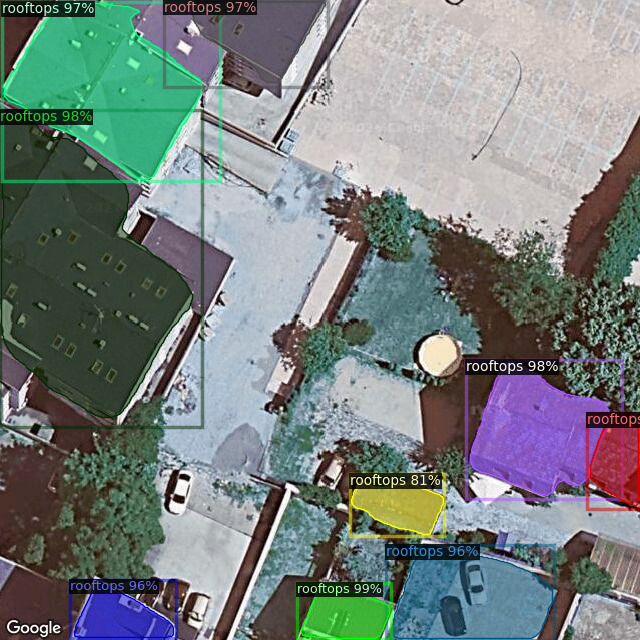

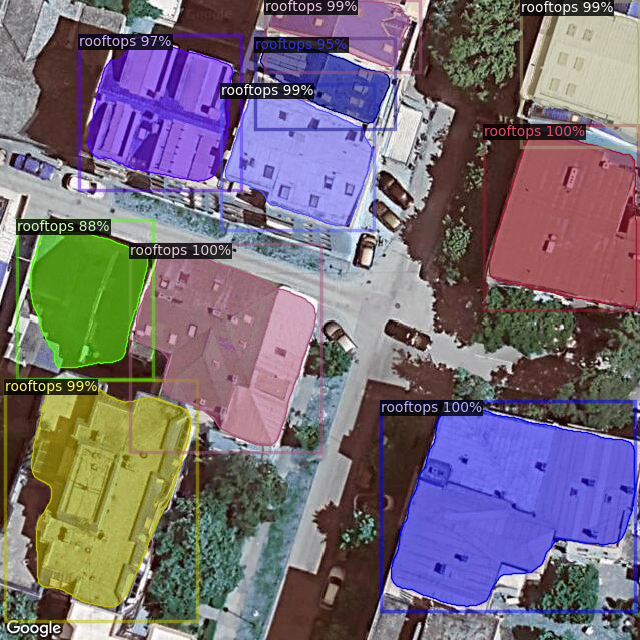

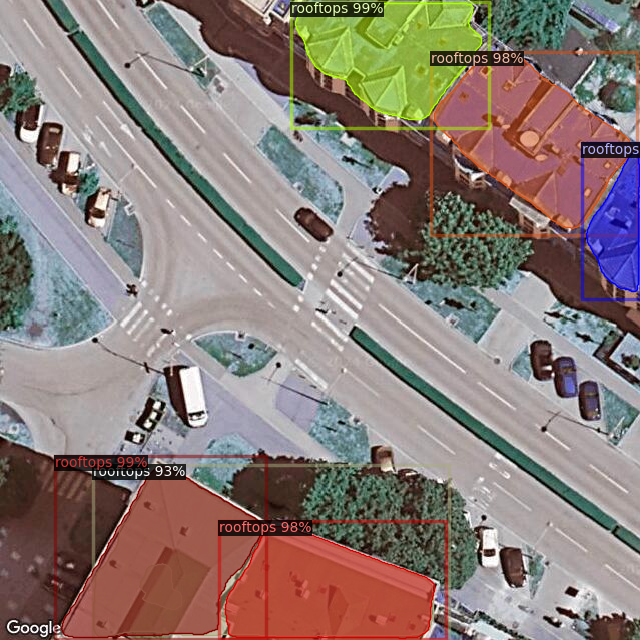

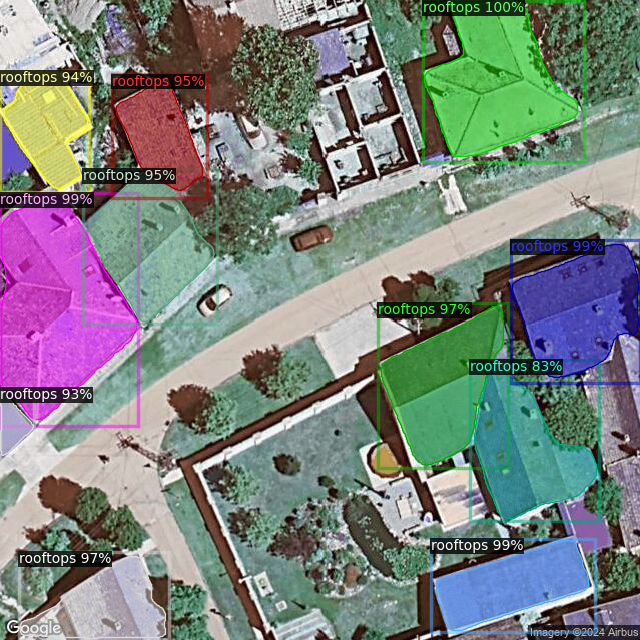

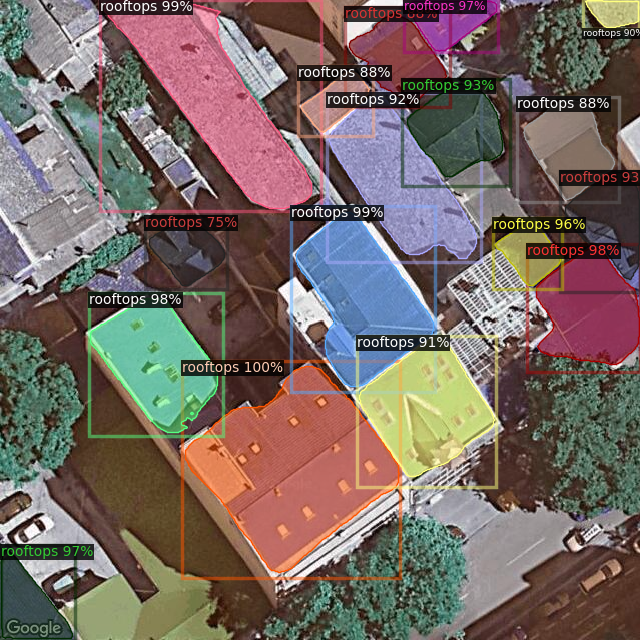

...

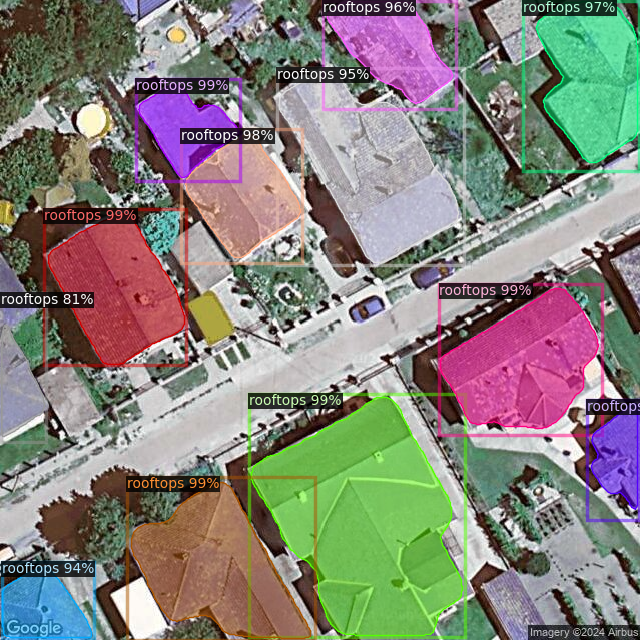

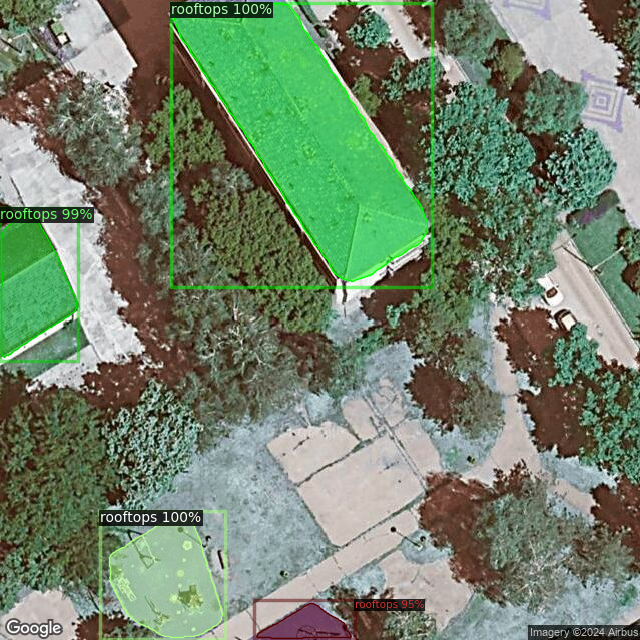

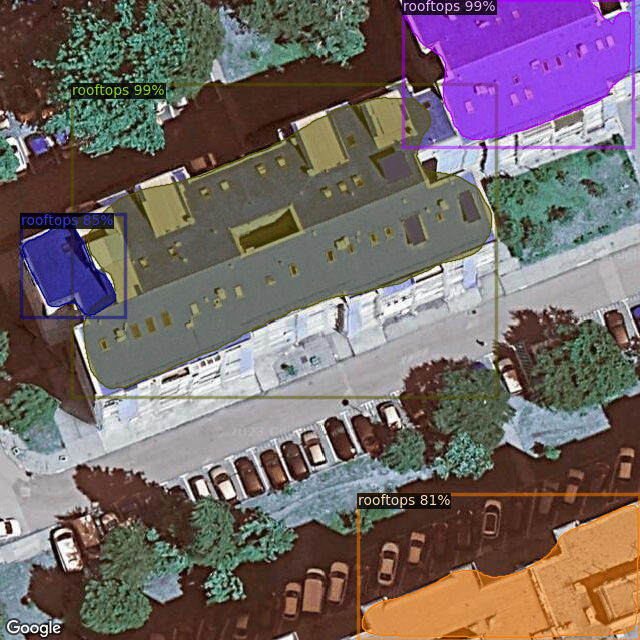

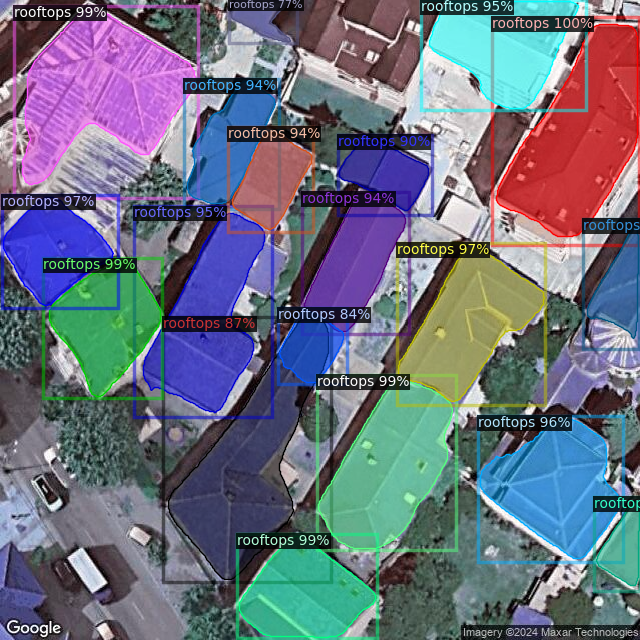

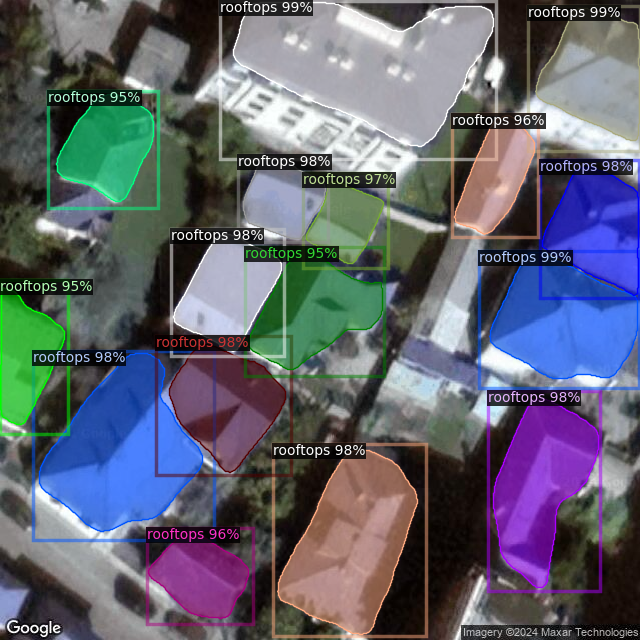

In [16]:
import random
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore", category=UserWarning)

if "trainer" in locals():
    del(trainer) # Free up memory just in case

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.75


# Create a predictor using the trained model
from detectron2.engine import DefaultPredictor
predictor = DefaultPredictor(cfg)

dataset_test = DatasetCatalog.get(TEST_DATA_SET_NAME)
test_metadata = MetadataCatalog.get(TEST_DATA_SET_NAME)

# Show some qualitative results by predicting on test set images
NUM_TEST_SAMPLES = 14
samples = random.sample(dataset_test, NUM_TEST_SAMPLES)
for i, sample in enumerate(samples):
    img = cv2.imread(sample["file_name"])
    outputs = predictor(img)
    visualizer = Visualizer(img, metadata=test_metadata)
    visualizer = visualizer.draw_instance_predictions(
        outputs["instances"].to("cpu"))
    cv2_imshow(visualizer.get_image()[:, :, ::-1])

# Plotting metrics

In [17]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir $OUTPUT_DIR_PATH

<IPython.core.display.Javascript object>